In [1]:
import sys
sys.path.append("../../")
import os
os.environ["CUDA_VISIBLE_DEVICES"]="2"
import glob
from csbdeep.models import Config, CARE
from faqt.helpers import doubleplot, WingArea, OrientationArea

Using TensorFlow backend.


In [2]:
Masterdir = '/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/WingCompartments/Original/'
Savedir = '/home/sancere/Kepler/CurieTrainingDatasets/Dalmiro_Laura/WingCompartments/WholeWing/'
Modeldir = '/home/sancere/Kepler/CurieDeepLearningModels/Dalmiro_Laura/'
Wingsegmentationmodel = 'DeepWingSegmentationModelUNET'
Wingcompartmentsegmentationmodel = 'WingCompartmentUNET'
WingVeinnmodel = 'WingVeinUNET'

UnetModel = CARE(config = None, name = Wingsegmentationmodel, basedir = Modeldir)
if Wingcompartmentsegmentationmodel is not None:
   UnetCompartmentModel = CARE(config = None, name = Wingcompartmentsegmentationmodel, basedir = Modeldir)
else:
   UnetCompartmentModel = None 
if WingVeinnmodel is not None:
   UnetVeinModel = CARE(config = None, name = WingVeinnmodel, basedir = Modeldir)
else:
   UnetVeinModel = None 


Instructions for updating:
If using Keras pass *_constraint arguments to layers.

Loading network weights from 'weights_best.h5'.
Loading network weights from 'weights_best.h5'.


# Parameters to be used for FAQT

In [3]:
#Display image every nth time n being
show_after = 1
#Wether to flip the image or just roatate it
flip = False
#minimum size of the wing, exclude small segmentation mistakes below these pixels
min_size = 15000
#Set this variable to false if computing just area
computeAsymmetry = False

/home/sancere/anaconda3/envs/tensorflowGPU/lib/python3.7/site-packages/csbdeep/models/base_model.py:255: UserWarning: skipping normalization step after prediction because number of input and output channels differ.
  warnings.warn('skipping normalization step after prediction because ' +


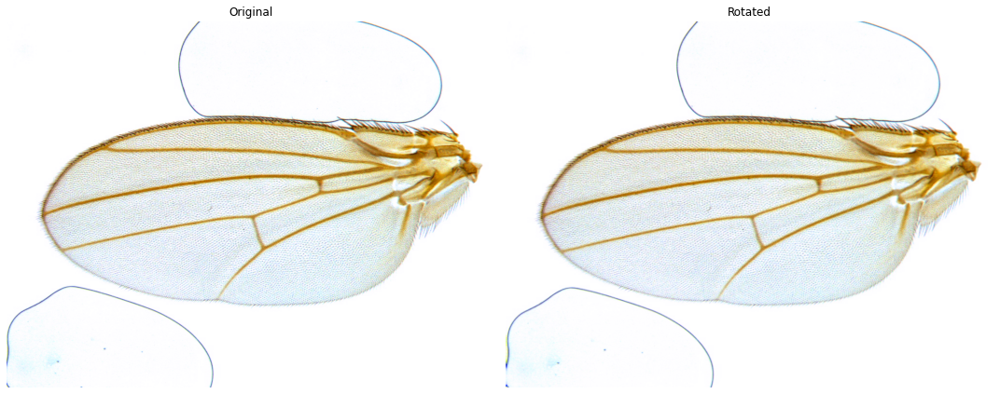

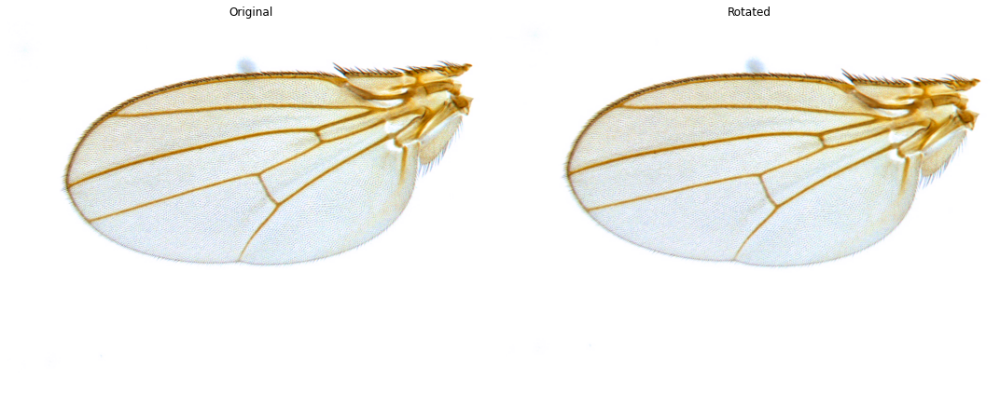

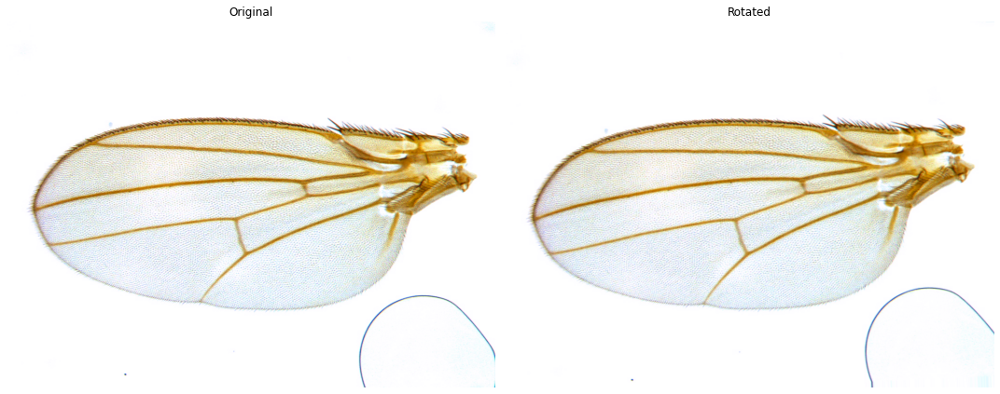

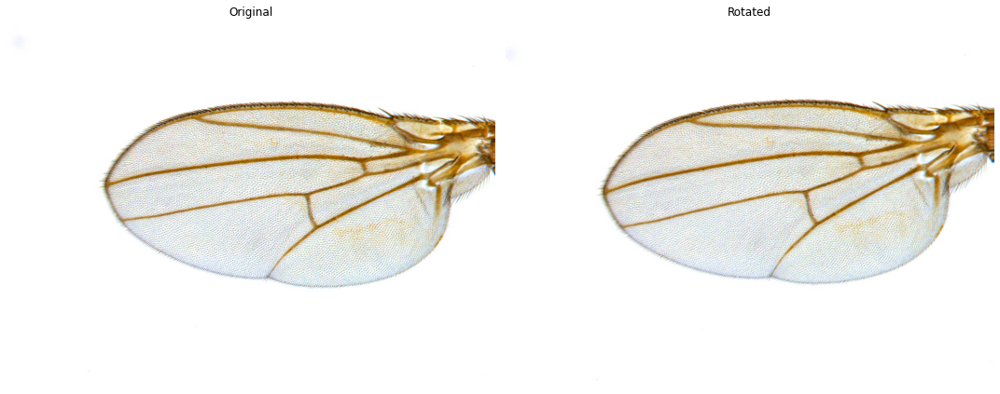

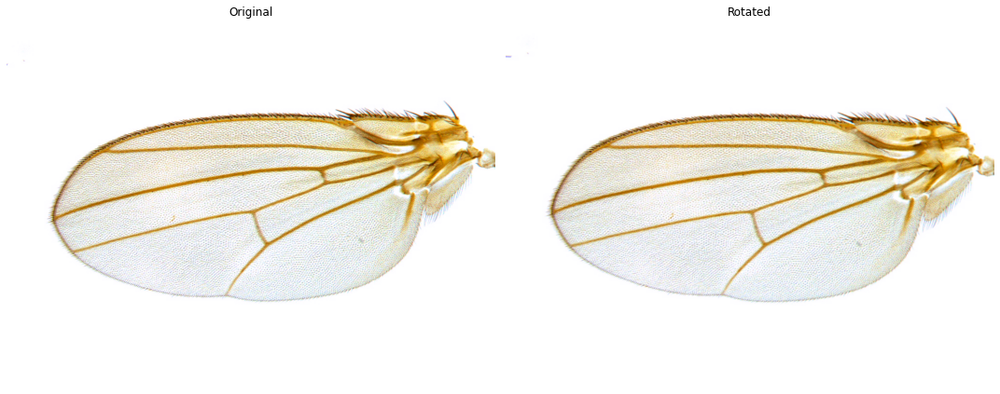

...

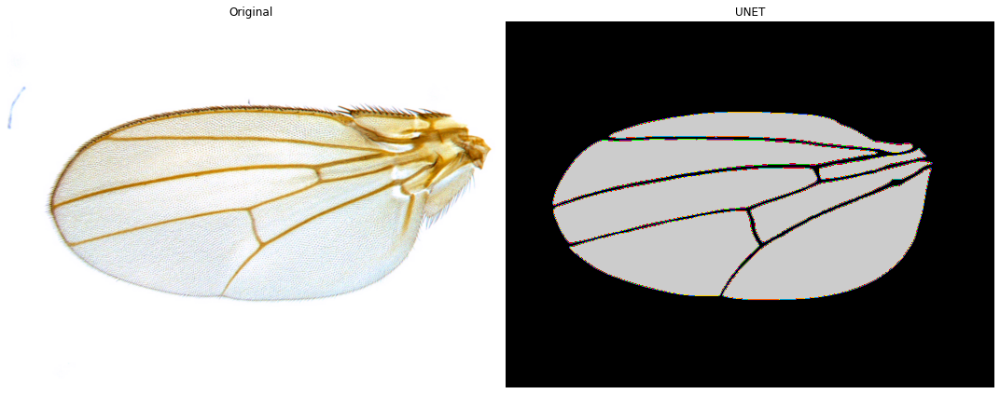

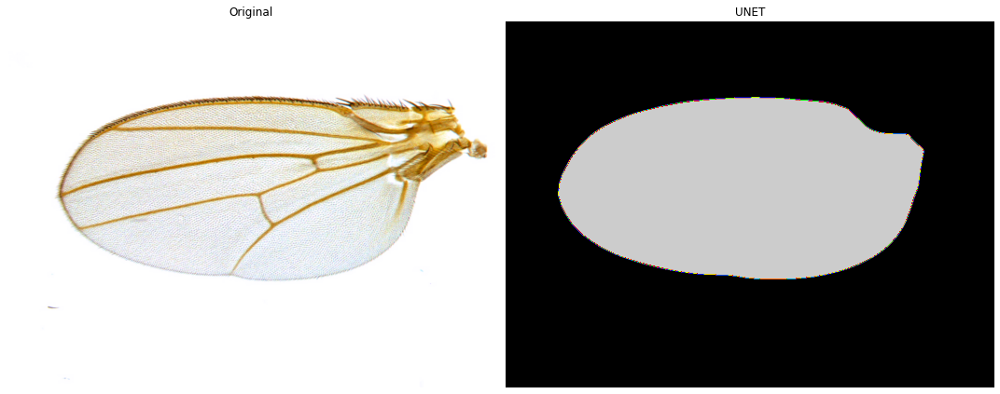

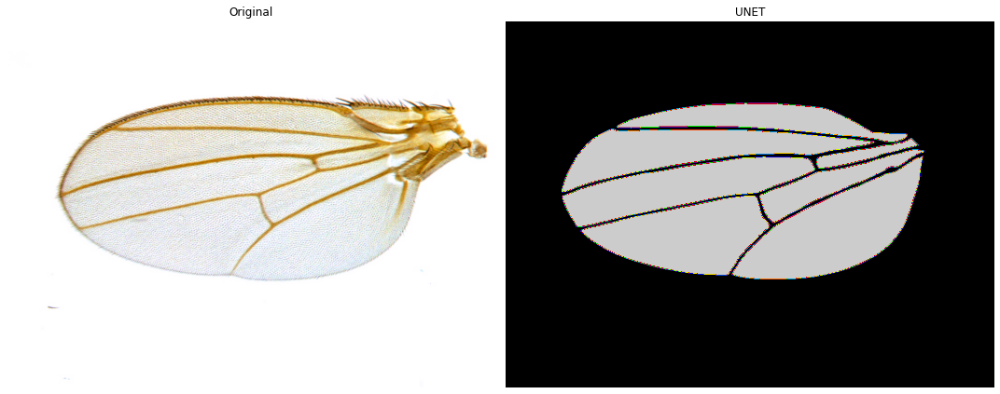

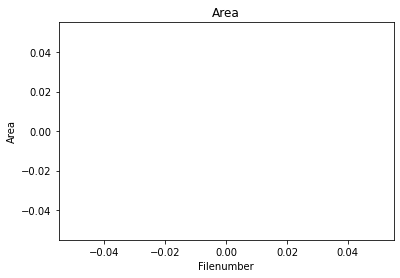

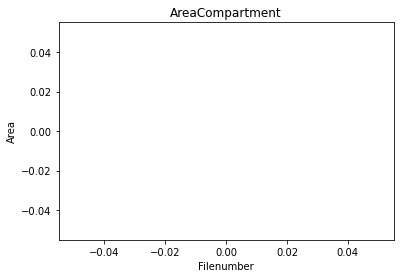

In [4]:
Raw_path = os.path.join(Masterdir, '*tif')
filesRaw = glob.glob(Raw_path)

OrientationArea(filesRaw, UnetModel, Savedir, show_after = show_after, min_size = min_size, flip = flip,
                UnetCompartmentModel = UnetCompartmentModel, UnetVeinModel = UnetVeinModel, computeAsymmetry = computeAsymmetry)
